# **Importing Libraries**

In [1]:
import math
import cv2 as cv
import numpy as np
import pandas as pd
from glob import glob
import matplotlib.pyplot as plt
%matplotlib inline

plt.rcParams['figure.figsize'] = [4, 4]

In [2]:
import tensorflow as tf
from tensorflow.keras import Model, Input
from tensorflow.keras.layers import Activation, Conv2D, BatchNormalization, MaxPool2D, UpSampling2D, Concatenate, Conv2DTranspose
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.metrics import MeanIoU
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.losses import sparse_categorical_crossentropy, SparseCategoricalCrossentropy
from tensorflow.keras.optimizers import Adam, AdamW
from tensorflow.keras import backend as K

2024-06-10 13:12:58.041958: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-10 13:12:58.042085: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-10 13:12:58.216767: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


# **Global Variables**

In [3]:
NUM_CLASSES = 29
BATCH_SIZE = 32

# **Data Visualization**

In [4]:
img = cv.imread('/kaggle/input/cityscapes/Cityspaces/images/train/aachen/aachen_000000_000019_leftImg8bit.png')

label = cv.imread('/kaggle/input/cityscapes/Cityspaces/gtFine/train/aachen/aachen_000000_000019_gtFine_color.png')

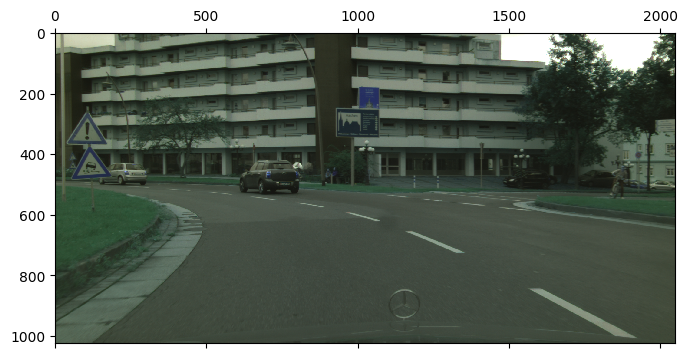

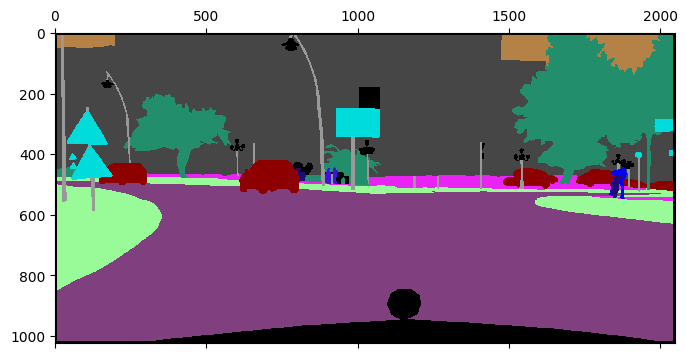

In [5]:
plt.matshow(img)
plt.matshow(label)
plt.show()

# **Data Preprocessing**

### ***Getting Unique Color Labels***

In [ ]:
def get_rgb_combinations(path):
    unique_val = set()
    
    folders = glob(path+'/*')
    
    for i in range(len(folders)):
        print(f'{i+1}) Folder Name: {folders[i]}')
        
        files = glob(folders[i]+'/*gtFine_color.png')
        
        for file in files:
            img = cv.imread(file)
            shape = img.shape
            flatten = np.reshape(img, (shape[0]*shape[1], shape[2])).tolist()

            uniq = set(tuple(rgb_pair) for rgb_pair in flatten)\

            unique_val.update(uniq)

            if len(unique_val) >= NUM_CLASSES:
                break
        
        print(f'Unique Values: {len(unique_val)}')
        print()
        
        if len(unique_val) >= NUM_CLASSES:
            break

    return unique_val

In [ ]:
colors = get_rgb_combinations('/kaggle/input/cityscapes/Cityspaces/gtFine/train')

### ***Color Labels got from get_rgb_combinations()***

In [6]:
colors = [
     (0, 0, 0),
     (0, 0, 255),
     (0, 74, 111),
     (0, 220, 220),
     (30, 170, 250),
     (32, 11, 119),
     (35, 142, 107),
     (60, 20, 220),
     (70, 0, 0),
     (70, 70, 70),
     (81, 0, 81),
     (90, 0, 0),
     (90, 120, 150),
     (100, 60, 0),
     (100, 80, 0),
     (100, 100, 150),
     (110, 0, 0),
     (128, 64, 128),
     (140, 150, 230),
     (142, 0, 0),
     (152, 251, 152),
     (153, 153, 153),
     (153, 153, 190),
     (156, 102, 102),
     (160, 170, 250),
     (180, 130, 70),
     (180, 165, 180),
     (230, 0, 0),
     (232, 35, 244),
]

In [7]:
color_to_index = {tuple(color): idx for idx, color in enumerate(colors)}
color_to_index

{(0, 0, 0): 0,
 (0, 0, 255): 1,
 (0, 74, 111): 2,
 (0, 220, 220): 3,
 (30, 170, 250): 4,
 (32, 11, 119): 5,
 (35, 142, 107): 6,
 (60, 20, 220): 7,
 (70, 0, 0): 8,
 (70, 70, 70): 9,
 (81, 0, 81): 10,
 (90, 0, 0): 11,
 (90, 120, 150): 12,
 (100, 60, 0): 13,
 (100, 80, 0): 14,
 (100, 100, 150): 15,
 (110, 0, 0): 16,
 (128, 64, 128): 17,
 (140, 150, 230): 18,
 (142, 0, 0): 19,
 (152, 251, 152): 20,
 (153, 153, 153): 21,
 (153, 153, 190): 22,
 (156, 102, 102): 23,
 (160, 170, 250): 24,
 (180, 130, 70): 25,
 (180, 165, 180): 26,
 (230, 0, 0): 27,
 (232, 35, 244): 28}

### ***Transforming target image to labels for classification***

In [8]:
def colour_to_id(img, axis=3):
    shape = img.shape
    flatten = img.reshape(-1, 3)
    
    arr = np.zeros(flatten.shape[0], dtype=int)
    
    for color, index in color_to_index.items():
        mask = np.all(flatten == color, axis=1)
        arr[mask] = index
        
    arr = arr.reshape(shape[:axis])
    
    return arr

### ***Mapping Colors to Resized images to get clearer boundaries***

In [9]:
def get_closest_color(rgb, color_list):
    d = 0
    c = color_list[0]
    for i in color_list:
        dist = math.dist(i, rgb)
        if i == c:
            d = dist
        elif dist < d:
            d = dist
            c = i
            
    return c

In [10]:
def clear_boundary(img):
    shape = img.shape
    flatten = img.copy()
    flatten = flatten.reshape(-1, 3)
    
    for i in range(len(flatten)):
        if tuple(flatten[i]) not in colors:
            flatten[i] = get_closest_color(flatten[i], colors)
            
    arr = flatten.reshape(shape)
    
    return arr

In [11]:
img = cv.resize(label, (256, 128))

In [12]:
sample = clear_boundary(img)

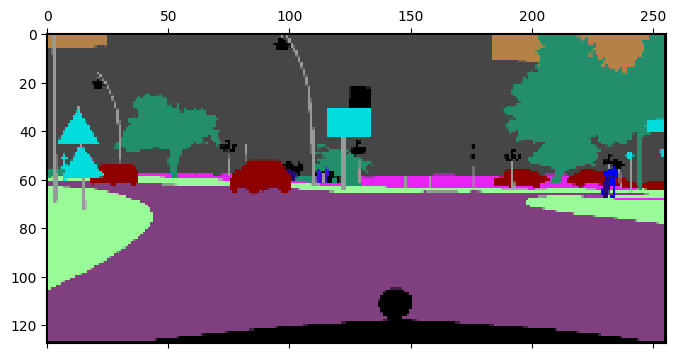

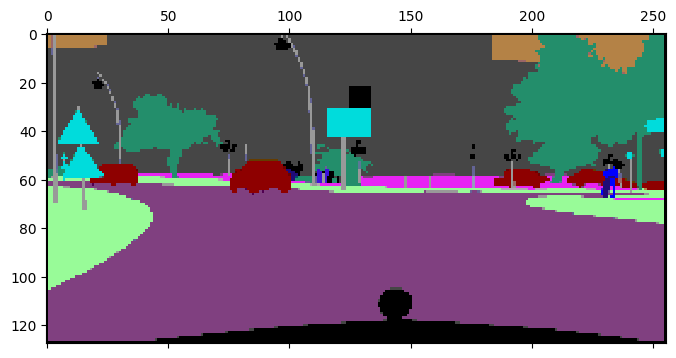

In [13]:
plt.matshow(img)
plt.matshow(sample)
plt.show()

### ***Reading the images***

In [ ]:
def get_img_arr(path):
    train_folders = glob(path+'/*')
    arr_x = []
    arr_y = []

    print('Processing Started...\n')
    for folder in train_folders:
        files = glob(folder+'/*.png')
        
        folder_name = folder.split('/')
        folder_name[5] = 'gtFine'
        y_folder = '/'.join(folder_name)
        
        count = 0

        for file in files:
            img = cv.imread(file)
            
            name = file.split('/')[-1].split('_')[:-1]
            name.append('gtFine_color.png')
            name = '_'.join(name)
            
            img_y = cv.imread(y_folder+'/'+name)
            
            #resize the image
            img = cv.resize(img, (256, 128))
            img_y = cv.resize(img_y, (256, 128))
            
            count += 1
            
            arr_x.append(img)
            arr_y.append(img_y)
        
        print(f'Processed {count} images from {folder_name[-1]}')
        
    print('\nProcessing Ended...') 
        
    return np.asarray(arr_x), np.asarray(arr_y)

In [ ]:
x_train, y_train = get_img_arr('/kaggle/input/cityscapes/Cityspaces/images/train')

In [ ]:
x_val, y_val = get_img_arr('/kaggle/input/cityscapes/Cityspaces/images/val')

### ***Defining the boundaries of the resized images***

In [ ]:
arr = []

for i in range(len(y_train)):
    arr.append(clear_boundary(y_train[i]))
    print(i)
    
y_train = np.asarray(arr)

In [ ]:
arr = []

for i in range(len(y_val)):
    arr.append(clear_boundary(y_val[i]))
    print(i)
    
y_val = np.asarray(arr)

### ***Saving the Preprocessed images***

In [ ]:
np.save('/kaggle/working/x_train.npy', x_train)

In [ ]:
np.save('/kaggle/working/x_val.npy', x_val)

In [ ]:
np.save('/kaggle/working/y_train.npy', y_train)

In [ ]:
np.save('/kaggle/working/y_val.npy', y_val)

### ***Loading the images***

In [14]:
x_train = np.load('/kaggle/input/d/vansh2101/cityscapes/x_train.npy')
y_train = np.load('/kaggle/input/d/vansh2101/cityscapes/y_train.npy')

In [15]:
x_val = np.load('/kaggle/input/d/vansh2101/cityscapes/x_val.npy')
y_val = np.load('/kaggle/input/d/vansh2101/cityscapes/y_val.npy')

### ***Data Augmentation***

In [ ]:
def horizontal_flip(x, y):
    img = x.copy()
    labels = y.copy()
    
    img = img[:, :, ::-1, :]
    labels = labels[:, :, ::-1, :]
    
    x_df = np.concatenate([x, img])
    y_df = np.concatenate([y, labels])
    
    return x_df, y_df

In [ ]:
x_train, y_train = horizontal_flip(x_train, y_train)

### ***Creating a custom generator for inputting images***

In [16]:
def create_generator(x, y, x_gen, y_gen, batch_size = BATCH_SIZE):
    x_gen = x_gen.flow(x, batch_size=batch_size, seed=10)
    y_gen = y_gen.flow(y, batch_size=batch_size, seed=10)
    
    while True:
        x_batch = x_gen.__next__()
        y_batch = y_gen.__next__()
        y_batch = colour_to_id(y_batch)
        
        yield x_batch, y_batch

In [17]:
train_x_img_gen = ImageDataGenerator()

train_x_img_gen.fit(x_train, augment=True)

In [18]:
train_y_img_gen = ImageDataGenerator()

train_y_img_gen.fit(y_train, augment=True)

In [19]:
val_x_img_gen = ImageDataGenerator()

val_x_img_gen.fit(x_val, augment=True)

In [20]:
val_y_img_gen = ImageDataGenerator()

val_y_img_gen.fit(y_val, augment=True)

In [21]:
train_generator = create_generator(x_train, y_train, train_x_img_gen, train_y_img_gen)

val_generator = create_generator(x_val, y_val, val_x_img_gen, val_y_img_gen)

# **Creating the Model Architecture**

### ***U-NET Architecture*** 

In [22]:
def encoder_block(inputs, filters, padding = 'same', dilation_rate=1, kernel_initializer='glorot_uniform'):
    layer = Conv2D(filters, kernel_size=3, padding=padding, dilation_rate=dilation_rate, kernel_initializer=kernel_initializer)(inputs)
    layer = Activation('relu')(layer)
    
    layer = Conv2D(filters, kernel_size=3, padding=padding, dilation_rate=dilation_rate, kernel_initializer=kernel_initializer)(layer)
    layer = Activation('relu')(layer)
    
    layer = MaxPool2D(pool_size=2, strides=2, padding=padding)(layer)
    
    return layer

In [23]:
class resize_tensor(tf.keras.Layer):
    def call(self, feature, size):
        return tf.image.resize(feature, size=size)

def decoder_block(inputs, filters, skip_features, padding = 'same'):
    layer = Conv2DTranspose(filters, kernel_size=2, strides=2, padding=padding)(inputs)
    
    features = resize_tensor()(skip_features, size=(layer.shape[1], layer.shape[2]))

    layer = Concatenate()([layer, features])
        
    layer = Conv2D(filters, kernel_size=3, padding=padding)(layer)
    layer = Activation('relu')(layer)
    
    layer = Conv2D(filters, kernel_size=3, padding=padding)(layer)
    layer = Activation('relu')(layer)
    
    return layer

In [24]:
def unet(input_shape):
    inputs = Input(shape = input_shape)
    
    #===============ENCODER===============
    block_1 = encoder_block(inputs, 64)
    block_2 = encoder_block(block_1, 128)
    block_3 = encoder_block(block_2, 256)
    block_4 = encoder_block(block_3, 512)
    
    #===============BOTTLENECK===============
    b1 = Conv2D(1024, 3, padding='same')(block_4) 
    b1 = Activation('relu')(b1) 
    b1 = Conv2D(1024, 3, padding='same')(b1) 
    b1 = Activation('relu')(b1)
    
    #===============DECODER===============
    block_5 = decoder_block(b1, 512, skip_features = block_4)
    block_6 = decoder_block(block_5, 256, skip_features = block_3)
    block_7 = decoder_block(block_6, 128, skip_features = block_2)
    block_8 = decoder_block(block_7, 64, skip_features = block_1)
    
    out = Conv2D(NUM_CLASSES, 1, padding='valid', activation='softmax')(block_8)
    
    #===============MODEL===============
    model = Model(inputs=inputs, outputs=out, name='U-Net')
    
    return model

### ***U-Net Architecture with dilated convolution layers***

In [25]:
def dilated_unet(input_shape):
    inputs = Input(shape = input_shape)
    
    #===============ENCODER===============
    block_1 = encoder_block(inputs, 64, dilation_rate=8, kernel_initializer='he_normal')
    block_2 = encoder_block(block_1, 128, dilation_rate=4, kernel_initializer='he_normal')
    block_3 = encoder_block(block_2, 256, dilation_rate=2, kernel_initializer='he_normal')
    block_4 = encoder_block(block_3, 512, dilation_rate=1, kernel_initializer='he_normal')
    
    #===============BOTTLENECK===============
    b1 = Conv2D(1024, 3, padding='same')(block_4) 
    b1 = Activation('relu')(b1) 
    b1 = Conv2D(1024, 3, padding='same')(b1) 
    b1 = Activation('relu')(b1)
    
    #===============DECODER===============
    block_5 = decoder_block(b1, 512, skip_features = block_4)
    block_6 = decoder_block(block_5, 256, skip_features = block_3)
    block_7 = decoder_block(block_6, 128, skip_features = block_2)
    block_8 = decoder_block(block_7, 64, skip_features = block_1)
    
    out = Conv2D(NUM_CLASSES, 1, padding='valid', activation='softmax')(block_8)
    
    #===============MODEL===============
    model = Model(inputs=inputs, outputs=out, name='Dilated_UNet')
    
    return model

### ***Modified U-Net Architecture***

In [26]:
def modified_unet(input_shape):
    inputs = Input(shape=input_shape)
    
    #===============ENCODER===============
    #block 1
    conv1 = Conv2D(64, (3,3), padding='same')(inputs)
    conv1 = BatchNormalization()(conv1)
    conv1 = Activation('relu')(conv1)
    
    conv1 = Conv2D(64, (3,3), padding='same')(conv1)
    conv1 = BatchNormalization()(conv1)
    conv1 = Activation('relu')(conv1)
    
    pool1 = MaxPool2D(pool_size=2, strides=2, padding='same')(conv1)
    
    
    #block 2
    conv2 = Conv2D(128, (3,3), padding='same')(pool1)
    conv2 = BatchNormalization()(conv2)
    conv2 = Activation('relu')(conv2)
    
    conv2 = Conv2D(128, (3,3), padding='same')(conv2)
    conv2 = BatchNormalization()(conv2)
    conv2 = Activation('relu')(conv2)
    
    pool2 = MaxPool2D(pool_size=2, strides=2, padding='same')(conv2)
    
    
    #block 3
    conv3 = Conv2D(256, (3,3), padding='same')(pool2)
    conv3 = BatchNormalization()(conv3)
    conv3 = Activation('relu')(conv3)
    
    conv3 = Conv2D(256, (3,3), padding='same')(conv3)
    conv3 = BatchNormalization()(conv3)
    conv3 = Activation('relu')(conv3)
    
    conv3 = Conv2D(256, (3,3), padding='same')(conv3)
    conv3 = BatchNormalization()(conv3)
    conv3 = Activation('relu')(conv3)
    
    pool3 = MaxPool2D(pool_size=2, strides=2, padding='same')(conv3)
    
    
    #block 4
    conv4 = Conv2D(512, (3,3), padding='same')(pool3)
    conv4 = BatchNormalization()(conv4)
    conv4 = Activation('relu')(conv4)
    
    conv4 = Conv2D(512, (3,3), padding='same')(conv4)
    conv4 = BatchNormalization()(conv4)
    conv4 = Activation('relu')(conv4)
    
    conv4 = Conv2D(512, (3,3), padding='same')(conv4)
    conv4 = BatchNormalization()(conv4)
    conv4 = Activation('relu')(conv4)
    
    pool4 = MaxPool2D(pool_size=2, strides=2, padding='same')(conv4)
    
    
    #block 5
    conv5 = Conv2D(1024, (3,3), padding='same')(pool4)
    conv5 = BatchNormalization()(conv5)
    conv5 = Activation('relu')(conv5)
    
    conv5 = Conv2D(1024, (3,3), padding='same')(conv5)
    conv5 = BatchNormalization()(conv5)
    conv5 = Activation('relu')(conv5)
    
    conv5 = Conv2D(1024, (3,3), padding='same')(conv5)
    conv5 = BatchNormalization()(conv5)
    conv5 = Activation('relu')(conv5)
    
    pool5 = MaxPool2D(pool_size=2, strides=2, padding='same')(conv5)
    
    
    #===============DECODER===============
    #block 6
    upsamp1 = UpSampling2D(size=(2,2))(pool5)
    
    deconv1 = Conv2D(512, (3,3), padding='same')(upsamp1)
    deconv1 = BatchNormalization()(deconv1)
    deconv1 = Activation('relu')(deconv1)
    
    deconv1 = Conv2D(512, (3,3), padding='same')(deconv1)
    deconv1 = BatchNormalization()(deconv1)
    deconv1 = Activation('relu')(deconv1)
    
    deconv1 = Conv2D(512, (3,3), padding='same')(deconv1)
    deconv1 = BatchNormalization()(deconv1)
    deconv1 = Activation('relu')(deconv1)
    
    
    #block 7
    concat2 = Concatenate()([deconv1, pool4]) #skip connection to block 4
    
    upsamp2 = UpSampling2D(size=(2,2))(concat2)
    
    deconv2 = Conv2D(512, (3,3), padding='same')(upsamp2)
    deconv2 = BatchNormalization()(deconv2)
    deconv2 = Activation('relu')(deconv2)
    
    deconv2 = Conv2D(512, (3,3), padding='same')(deconv2)
    deconv2 = BatchNormalization()(deconv2)
    deconv2 = Activation('relu')(deconv2)
    
    deconv2 = Conv2D(256, (3,3), padding='same')(deconv2)
    deconv2 = BatchNormalization()(deconv2)
    deconv2 = Activation('relu')(deconv2)
    
    
    #block 8
    concat3 = Concatenate()([deconv2, pool3]) #skip connection to block 3
    
    upsamp3 = UpSampling2D(size=(2,2))(concat3)
    
    deconv3 = Conv2D(256, (3,3), padding='same')(upsamp3)
    deconv3 = BatchNormalization()(deconv3)
    deconv3 = Activation('relu')(deconv3)
    
    deconv3 = Conv2D(256, (3,3), padding='same')(deconv3)
    deconv3 = BatchNormalization()(deconv3)
    deconv3 = Activation('relu')(deconv3)
    
    deconv3 = Conv2D(128, (3,3), padding='same')(deconv3)
    deconv3 = BatchNormalization()(deconv3)
    deconv3 = Activation('relu')(deconv3)
    
    
    #block 9
    concat4 = Concatenate()([deconv3, pool2]) #skip connection to block 2
    
    upsamp4 = UpSampling2D(size=(2,2))(concat4)
    
    deconv4 = Conv2D(128, (3,3), padding='same')(upsamp4)
    deconv4 = BatchNormalization()(deconv4)
    deconv4 = Activation('relu')(deconv4)
    
    deconv4 = Conv2D(64, (3,3), padding='same')(deconv4)
    deconv4 = BatchNormalization()(deconv4)
    deconv4 = Activation('relu')(deconv4)
    
    
    #block 10
    concat5 = Concatenate()([deconv4, pool1]) #skip connection to block 1
    
    upsamp5 = UpSampling2D(size=(2,2))(concat5)
    
    deconv5 = Conv2D(64, (3,3), padding='same')(upsamp5)
    deconv5 = BatchNormalization()(deconv5)
    deconv5 = Activation('relu')(deconv5)
    
    deconv5 = Conv2D(NUM_CLASSES, (1,1), padding='same')(deconv5) #pixel-wise classification
    deconv5 = BatchNormalization()(deconv5)
    deconv5 = Activation('softmax')(deconv5)
    
    
    #===============MODEL===============
    model = Model(inputs=inputs, outputs=deconv5, name='Modified-UNet')
    
    return model

### ***SEGNET Architecture***

In [27]:
class MaxPoolingWithArgmax2D(tf.keras.Layer):
    def __init__(self, pool_size=(2, 2), strides=(2, 2), padding='same', **kwargs):
        super(MaxPoolingWithArgmax2D, self).__init__(**kwargs)
        self.pool_size = pool_size
        self.strides = strides
        self.padding = padding

    def call(self, inputs, **kwargs):
        pool, argmax = tf.nn.max_pool_with_argmax(
            inputs,
            ksize=self.pool_size,
            strides=self.strides,
            padding=self.padding.upper()
        )
        argmax = tf.cast(argmax, tf.float32)
        return pool, argmax

    def compute_output_shape(self, input_shape):
        if self.padding == 'valid':
            output_shape = [
                input_shape[0],
                (input_shape[1] - self.pool_size[0] + 1) // self.strides[0],
                (input_shape[2] - self.pool_size[1] + 1) // self.strides[1],
                input_shape[3]
            ]
        else:
            output_shape = [
                input_shape[0],
                input_shape[1] // self.strides[0],
                input_shape[2] // self.strides[1],
                input_shape[3]
            ]
        return [tf.TensorShape(output_shape), tf.TensorShape(output_shape)]

In [28]:
class MaxUnpooling2D(tf.keras.Layer):
    def __init__(self, pool_size=(2, 2), **kwargs):
        super(MaxUnpooling2D, self).__init__(**kwargs)
        self.pool_size = pool_size

    def call(self, inputs, output_shape=None):
        updates, mask = inputs
        mask = tf.cast(mask, 'int32')
        input_shape = tf.shape(updates, out_type='int32')
        
        if output_shape is None:
            output_shape = (input_shape[0],
                            input_shape[1] * self.pool_size[0],
                            input_shape[2] * self.pool_size[1],
                            input_shape[3])

        
        one_like_mask = tf.ones_like(mask, dtype='int32')
        batch_shape = tf.concat([[input_shape[0]], [1], [1], [1]], axis=0)
        batch_range = tf.reshape(tf.range(output_shape[0], dtype='int32'), shape=batch_shape)
        b = one_like_mask * batch_range
        y = mask // (output_shape[2] * output_shape[3])
        x = (mask // output_shape[3]) % output_shape[2]
        feature_range = tf.range(output_shape[3], dtype='int32')
        f = one_like_mask * feature_range

        
        updates_size = tf.size(updates)
        indices = tf.transpose(tf.reshape(tf.stack([b, y, x, f]), [4, updates_size]))
        values = tf.reshape(updates, [updates_size])
        ret = tf.scatter_nd(indices, values, output_shape)

        return ret

    def compute_output_shape(self, input_shape):
        return (input_shape[0][0],
                input_shape[0][1] * self.pool_size[0],
                input_shape[0][2] * self.pool_size[1],
                input_shape[0][3])

In [29]:
def segnet(input_shape, num_classes=NUM_CLASSES):
    inputs = Input(shape=input_shape)
    
    #===============ENCODER===============
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(inputs)
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    p1, idx1 = MaxPoolingWithArgmax2D(pool_size=(2, 2))(x)

    x = Conv2D(128, (3, 3), padding='same', activation='relu')(p1)
    x = Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    p2, idx2 = MaxPoolingWithArgmax2D(pool_size=(2, 2))(x)

    x = Conv2D(256, (3, 3), padding='same', activation='relu')(p2)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    p3, idx3 = MaxPoolingWithArgmax2D(pool_size=(2, 2))(x)

    x = Conv2D(512, (3, 3), padding='same', activation='relu')(p3)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    p4, idx4 = MaxPoolingWithArgmax2D(pool_size=(2, 2))(x)

    x = Conv2D(512, (3, 3), padding='same', activation='relu')(p4)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    p5, idx5 = MaxPoolingWithArgmax2D(pool_size=(2, 2))(x)

    #===============DECODER===============
    x = MaxUnpooling2D(pool_size=(2, 2))([p5, idx5])
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)

    x = MaxUnpooling2D(pool_size=(2, 2))([x, idx4])
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)

    x = MaxUnpooling2D(pool_size=(2, 2))([x, idx3])
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(128, (3, 3), padding='same', activation='relu')(x)

    x = MaxUnpooling2D(pool_size=(2, 2))([x, idx2])
    x = Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)

    x = MaxUnpooling2D(pool_size=(2, 2))([x, idx1])
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    
    outputs = Conv2D(num_classes, (1, 1), padding='same', activation='softmax')(x)
    
    #===============MODEL===============
    model = Model(inputs=inputs, outputs=outputs, name='SEGNET')
    
    return model

# **Loss Functions for Training**

### ***Dice Loss***

In [30]:
def dice_loss(y_true, y_pred, smooth=1e-10):
    true = tf.reshape(y_true, [-1])
    pred = tf.reshape(y_pred, [-1])
    
    intersection = tf.math.reduce_sum(true * pred)
    union = tf.math.reduce_sum(true + pred)
    
    dice_coeff = (2 * intersection + smooth) / (union + smooth)
    
    return 1 - dice_coeff

In [31]:
def custom_dice_loss(y_true, y_pred):
    true_ohe = tf.one_hot(tf.cast(y_true, tf.int32), depth=NUM_CLASSES)
    
    return dice_loss(true_ohe, y_pred)

### ***IoU Loss***

In [32]:
def iou_loss(y_true, y_pred, smooth=1e-10):
    intersection = tf.math.reduce_sum(y_true * y_pred, axis=[1, 2])
    union = tf.math.reduce_sum(y_true + y_pred, axis=[1, 2]) - intersection
    
    iou = (intersection + smooth) / (union + smooth)
    
    loss = 1 - iou
    return tf.math.reduce_mean(loss)

In [33]:
def custom_iou_loss(y_true, y_pred):
    true_ohe = tf.one_hot(tf.cast(y_true, tf.int32), depth=NUM_CLASSES)
    
    return iou_loss(true_ohe, y_pred)

### ***Combination of SparseCategoricalCrossentropy and Dice Loss***

In [34]:
def sparse_dice_categorical_loss(y_true, y_pred):
    true_ohe = tf.one_hot(tf.cast(y_true, tf.int32), depth=NUM_CLASSES)
    
    return sparse_categorical_crossentropy(y_true, y_pred) + dice_loss(true_ohe, y_pred)

### ***Combination of SparseCategoricalCrossentropy, Dice and IoU Loss***

In [35]:
def iou_dice_categorical_loss(y_true, y_pred, alpha = 0.3, beta = 0.4, gamma = 0.3):
    true_ohe = tf.one_hot(tf.cast(y_true, tf.int32), depth=NUM_CLASSES)
    
    iou = iou_loss(true_ohe, y_pred)
    dice = dice_loss(true_ohe, y_pred)
    sparse = sparse_categorical_crossentropy(y_true, y_pred)
    
    loss = (alpha * iou) + (beta * sparse) + (gamma * dice)
    
    return loss

# **Model Training**

In [36]:
input_shape = (128, 256, 3)

In [37]:
early_stop = EarlyStopping(
    monitor = 'val_loss',
    patience = 5,
    verbose = 1,
    restore_best_weights = True
)

In [38]:
mean_iou = MeanIoU(
    num_classes = NUM_CLASSES,
    sparse_y_pred = False
)

### ***Training U-Net***

In [39]:
unet_model = unet(input_shape)
unet_model.summary()

Model: "U-Net"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 256,  │      1,792 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 128, 256,  │          0 │ conv2d[0][0]      │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 256,  │     36,928 │ activation[0][0]  │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 128, 256,  │          0 │ conv2d_1[0][0]    │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 64, 128,   │          0 │ activation_1[0][… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 128,   │     73,856 │ max_pooling2d[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 64, 128,   │          0 │ conv2d_2[0][0]    │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 128,   │    147,584 │ activation_2[0][… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 64, 128,   │          0 │ conv2d_3[0][0]    │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 32, 64,    │          0 │ activation_3[0][… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 32, 64,    │    295,168 │ max_pooling2d_1[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, 32, 64,    │          0 │ conv2d_4[0][0]    │
│ (Activation)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 32, 64,    │    590,080 │ activation_4[0][… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_5        │ (None, 32, 64,    │          0 │ conv2d_5[0][0]    │
│ (Activation)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 16, 32,    │          0 │ activation_5[0][… │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 16, 32,    │  1,180,160 │ max_pooling2d_2[

 Total params: 31,033,565 (118.38 MB)

 Trainable params: 31,033,565 (118.38 MB)

 Non-trainable params: 0 (0.00 B)

In [40]:
tf.keras.utils.plot_model(
    unet_model,
    show_shapes = True,
    dpi = 1000
)

In [ ]:
unet_model.compile(optimizer=Adam(),
              loss=SparseCategoricalCrossentropy(),
              metrics=[
                  "accuracy",
                  mean_iou
              ]
             )

In [ ]:
epochs = 100
steps_per_epoch = len(x_train) // BATCH_SIZE
validation_steps = len(x_val) // BATCH_SIZE

history = unet_model.fit(
    train_generator,
    epochs=epochs,
    steps_per_epoch = steps_per_epoch,
    validation_data = val_generator,
    validation_steps = validation_steps,
    callbacks = early_stop
)

### ***Training Dilated U-Net***

In [41]:
dilated_unet_model = dilated_unet(input_shape)
dilated_unet_model.summary()

Model: "Dilated_UNet"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 128, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_19 (Conv2D)  │ (None, 128, 256,  │      1,792 │ input_layer_1[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_18       │ (None, 128, 256,  │          0 │ conv2d_19[0][0]   │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_20 (Conv2D)  │ (None, 128, 256,  │     36,928 │ activation_18[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_19       │ (None, 128, 256,  │          0 │ conv2d_20[0][0]   │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 64, 128,   │          0 │ activation_19[0]… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_21 (Conv2D)  │ (None, 64, 128,   │     73,856 │ max_pooling2d_4[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_20       │ (None, 64, 128,   │          0 │ conv2d_21[0][0]   │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_22 (Conv2D)  │ (None, 64, 128,   │    147,584 │ activation_20[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_21       │ (None, 64, 128,   │          0 │ conv2d_22[0][0]   │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_5     │ (None, 32, 64,    │          0 │ activation_21[0]… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_23 (Conv2D)  │ (None, 32, 64,    │    295,168 │ max_pooling2d_5[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_22       │ (None, 32, 64,    │          0 │ conv2d_23[0][0]   │
│ (Activation)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_24 (Conv2D)  │ (None, 32, 64,    │    590,080 │ activation_22[0]… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_23       │ (None, 32, 64,    │          0 │ conv2d_24[0][0]   │
│ (Activation)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 16, 32,    │          0 │ activation_23[0]… │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_25 (Conv2D)  │ (None, 16, 32,    │  1,180,160 │ max_pooling2d_6[

 Total params: 31,033,565 (118.38 MB)

 Trainable params: 31,033,565 (118.38 MB)

 Non-trainable params: 0 (0.00 B)

In [42]:
tf.keras.utils.plot_model(
    dilated_unet_model,
    show_shapes = True,
    dpi = 1000
)

In [ ]:
dilated_unet_model.compile(optimizer=AdamW(),
              loss=iou_dice_categorical_loss,
              metrics=[
                  "accuracy",
                  mean_iou
              ]
             )

In [ ]:
epochs = 100
steps_per_epoch = len(x_train) // BATCH_SIZE
validation_steps = len(x_val) // BATCH_SIZE

history = dilated_unet_model.fit(
    train_generator,
    epochs=epochs,
    steps_per_epoch = steps_per_epoch,
    validation_data = val_generator,
    validation_steps = validation_steps,
    callbacks = early_stop
)

### ***Training Modified U-Net model***

In [43]:
mod_unet_model = modified_unet(input_shape)
mod_unet_model.summary()

Model: "Modified-UNet"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2       │ (None, 128, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_38 (Conv2D)  │ (None, 128, 256,  │      1,792 │ input_layer_2[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 128, 256,  │        256 │ conv2d_38[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_36       │ (None, 128, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_39 (Conv2D)  │ (None, 128, 256,  │     36,928 │ activation_36[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 256,  │        256 │ conv2d_39[0][0]   │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_37       │ (None, 128, 256,  │          0 │ batch_normalizat… │
│ (Activation)        │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_8     │ (None, 64, 128,   │          0 │ activation_37[0]… │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_40 (Conv2D)  │ (None, 64, 128,   │     73,856 │ max_pooling2d_8[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 128,   │        512 │ conv2d_40[0][0]   │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_38       │ (None, 64, 128,   │          0 │ batch_normalizat… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_41 (Conv2D)  │ (None, 64, 128,   │    147,584 │ activation_38[0]… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 128,   │        512 │ conv2d_41[0][0]   │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_39       │ (None, 64, 128,   │          0 │ batch_normalizat… │
│ (Activation)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_9     │ (None, 32, 64,    │          0 │ activation_39[0]… │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_42 (Conv2D)  │ (None, 32, 64,    │    295,168 │ max_pooling2d_9[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 32, 64,    │      1,024 │ conv2d_42[0][0] 

 Total params: 51,476,369 (196.37 MB)

 Trainable params: 51,457,367 (196.29 MB)

 Non-trainable params: 19,002 (74.23 KB)

In [44]:
tf.keras.utils.plot_model(
    mod_unet_model,
    show_shapes = True,
    dpi = 1000
)

In [ ]:
mod_unet_model.compile(optimizer=Adam(),
              loss=iou_dice_categorical_loss,
              metrics=[
                  "accuracy",
                  mean_iou
              ]
             )

In [ ]:
epochs = 100
steps_per_epoch = len(x_train) // BATCH_SIZE
validation_steps = len(x_val) // BATCH_SIZE

history = mod_unet_model.fit(
    train_generator,
    epochs=epochs,
    steps_per_epoch = steps_per_epoch,
    validation_data = val_generator,
    validation_steps = validation_steps,
    callbacks = early_stop
)

### ***Training SEGNET model***

In [45]:
segnet_model = segnet(input_shape)
segnet_model.summary()

Model: "SEGNET"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3       │ (None, 128, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_64 (Conv2D)  │ (None, 128, 256,  │      1,792 │ input_layer_3[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_65 (Conv2D)  │ (None, 128, 256,  │     36,928 │ conv2d_64[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling_with_a… │ [(None, 64, 128,  │          0 │ conv2d_65[0][0]   │
│ (MaxPoolingWithArg… │ 64), (None, 64,   │            │                   │
│                     │ 128, 64)]         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_66 (Conv2D)  │ (None, 64, 128,   │     73,856 │ max_pooling_with… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_67 (Conv2D)  │ (None, 64, 128,   │    147,584 │ conv2d_66[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling_with_a… │ [(None, 32, 64,   │          0 │ conv2d_67[0][0]   │
│ (MaxPoolingWithArg… │ 128), (None, 32,  │            │                   │
│                     │ 64, 128)]         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_68 (Conv2D)  │ (None, 32, 64,    │    295,168 │ max_pooling_with… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_69 (Conv2D)  │ (None, 32, 64,    │    590,080 │ conv2d_68[0][0]   │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_70 (Conv2D)  │ (None, 32, 64,    │    590,080 │ conv2d_69[0][0]   │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling_with_a… │ [(None, 16, 32,   │          0 │ conv2d_70[0][0]   │
│ (MaxPoolingWithArg… │ 256), (None, 16,  │            │                   │
│                     │ 32, 256)]         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_71 (Conv2D)  │ (None, 16, 32,    │  1,180,160 │ max_pooling_with… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_72 (Conv2D)  │ (None, 16, 32,    │  2,359,808 │ conv2d_71[0][0]   │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_73 (Conv2D)  │ (None, 16, 32,    │  2,359,808 │ conv2d_72[0][0]   │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling_with_a… │ [(None, 8, 16,    │          0 │ conv2d_73[0][0]   │
│ (MaxPoolingWithArg… │ 512), (None, 8,   │            │                   │
│                     │ 16, 512)]         │            │                   │
├─────────────────────┼───────────────────┼────────────┼─────────────────

 Total params: 29,429,021 (112.26 MB)

 Trainable params: 29,429,021 (112.26 MB)

 Non-trainable params: 0 (0.00 B)

In [46]:
tf.keras.utils.plot_model(
    segnet_model,
    show_shapes = True,
    dpi = 1000
)

In [ ]:
segnet_model.compile(optimizer=Adam(),
              loss=iou_dice_categorical_loss,
              metrics=[
                  "accuracy",
                  mean_iou
              ]
             )

In [ ]:
epochs = 100
steps_per_epoch = len(x_train) // BATCH_SIZE
validation_steps = len(x_val) // BATCH_SIZE

history = segnet_model.fit(
    train_generator,
    epochs=epochs,
    steps_per_epoch = steps_per_epoch,
    validation_data = val_generator,
    validation_steps = validation_steps,
    callbacks = early_stop
)

# **Plotting the loss and metrics of the Model**

In [ ]:
val_accuracy = history.history['val_accuracy']
val_loss = history.history['val_loss']
val_iou = history.history['val_mean_io_u']

In [ ]:
plt.plot(val_accuracy)
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Validation Accuracy')

In [ ]:
plt.plot(val_loss)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Validation Loss')

In [ ]:
plt.plot(val_iou)
plt.xlabel('Epochs')
plt.ylabel('IoU')
plt.title('Validation IoU')

# **Making the Predictions & Visualizing the Output**

In [ ]:
def segment_image(img, model):
    shape = img.shape
    
    model_input = np.expand_dims(img, axis = 0)
    
    out = model.predict(model_input)
    out = np.argmax(out, axis=3)
    
    flatten = out.reshape(-1)
    arr = np.zeros((flatten.shape[0], 3), dtype=int)
    
    for color, index in color_to_index.items():
        mask = flatten == index
        arr[mask] = color
        
    arr = arr.reshape(shape[0], shape[1], 3)
    
    return arr

In [ ]:
segmented_image = segment_image(x_val[50], dilated_unet_model)

In [ ]:
plt.matshow(x_val[50])
plt.matshow(y_val[50])
plt.matshow(segmented_image)

### ***Saving the Model***

In [ ]:
dilated_unet_model.save('/kaggle/working/dilated_unet.h5')

In [ ]:
segnet_model.save('/kaggle/working/segnet-v2.h5')